# **Flower Dataset**

## **Training**

### Reading dataset

### Splitting data into test and train 

In [1]:
import collections
import io
import math
from google.colab import drive
import numpy as np
import os
import random
import seaborn as sns
import sklearn.metrics as sk_metrics
from six.moves import urllib
from IPython.display import clear_output, Image, display, HTML
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import tensorflow_hub as hub
import matplotlib.pyplot as plt
import time

drive.mount('/content/drive',force_remount=True)


#mounting drive to colab notebook, so that data can be read
flowers_directory = 'drive/My Drive/Colab Notebooks/CV-A1/flower_photos'
TRAIN_PART = 0.8
training_names = os.listdir(flowers_directory)
print(training_names)

#splitting data into test and train 
def make_train_and_test_sets():
  test_examples, train_examples = [], []
  shuffler = random.Random(2018)
  is_root = True
  for (dirname, subdirs, filenames) in tf.gfile.Walk(flowers_directory):
    # Root directory gives us class names
    if is_root:
      subdirs = subdirs
      classes = collections.OrderedDict(enumerate(subdirs))
      label_to_class = dict([(x, i) for i, x in enumerate(subdirs)])
      is_root = False

    # Sub directories give us image files.
    else:
      filenames.sort()
      shuffler.shuffle(filenames)
      full_filenames = [os.path.join(dirname, f) for f in filenames]
      label = dirname.split('/')[-1]
      label_class = label_to_class[label]

      # An example is the image file and it's label class.
      examples = list(zip(full_filenames, [label_class] * len(filenames)))
      num_train = int(len(filenames) * TRAIN_PART)
      train_examples.extend(examples[:num_train])
      test_examples.extend(examples[num_train:])

  shuffler.shuffle(train_examples)
  shuffler.shuffle(test_examples)
  return train_examples, test_examples, classes

Instructions for updating:
non-resource variables are not supported in the long term


Mounted at /content/drive
['roses', 'tulips', 'dandelion', 'daisy', 'sunflowers']


In [2]:
training_examples, test_examples, classes = make_train_and_test_sets()
NUM_CLASSES = len(classes)


print('There are training images' , len(training_examples))
print('there are test images', len(test_examples))
print('The dataset has %d label classes:' , NUM_CLASSES, classes.values())

There are training images 2942
there are test images 738
The dataset has %d label classes: 5 odict_values(['roses', 'tulips', 'dandelion', 'daisy', 'sunflowers'])


### Feature Extraction

In [3]:
from google.colab.patches import cv2_imshow
import cv2

#SIFT descriptor
sift = cv2.xfeatures2d.SIFT_create()

#descriptors are appended in a list
descriptor_list = []

for i in range(0,len(training_examples)):
  img=cv2.imread(training_examples[i][0])
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  frames,descriptors = sift.detectAndCompute(img, None)
  #sift_image = cv2.drawKeypoints(gray,frames, img)
  # show the image
  #cv2_imshow(sift_image)
  descriptor_list.append((training_examples[i][0], descriptors)) 



### Codebook construction

In [22]:
from scipy.cluster.vq import kmeans, vq

#Visual vocabulary is formed by clustering.
descript = descriptor_list[0][1]

for image_path, descriptor in descriptor_list[1:]:
    descriptors = np.vstack((descript, descriptor))  

# Perform k-means clustering 
descript_float = descriptors.astype(float) 

k = 100 # this is a parameter. this value gave good result in my case
voc, variance = kmeans(descript_float, k, 1)
print(voc) 


[[  9.          46.           0.         ...   0.           0.
   21.        ]
 [ 16.54545455  42.54545455  41.72727273 ...  18.36363636  15.54545455
   13.        ]
 [ 41.75        35.75         3.25       ...   5.5          3.5
   16.        ]
 ...
 [  3.          32.42857143 102.         ...  21.42857143  12.14285714
   13.14285714]
 [ 40.28571429   8.57142857   9.85714286 ...   9.57142857   2.57142857
    9.85714286]
 [  6.7         11.6         13.         ...  15.6         11.3
   14.6       ]]


In [23]:
image_train_paths=[]
for i in range(len(training_examples)):
  image_train_paths.append(training_examples[i][0])

In [24]:
image_train_labels=[]
for i in range(len(training_examples)):
  image_train_labels.append(training_examples[i][1])

In [25]:

#plotting frequency histogram from clusters

image_features = np.zeros((len(training_examples), k), "float32")
for i in range(len(training_examples)):
    words, distance = vq(descriptor_list[i][1],voc)
    for w in words:
        image_features[i][w] += 1

# Vectorization
occurences = np.sum( (image_features > 0) * 1, axis = 0)
idf = np.array(np.log((1.0*len(image_train_paths)+1) / (1.0*occurences + 1)), 'float32')


### Classification using SVM

In [26]:
#Normalizing features
from sklearn.preprocessing import StandardScaler
import joblib
from sklearn.svm import LinearSVC


stdSlr = StandardScaler().fit(image_features)
im_features = stdSlr.transform(image_features)

#Training SVM
clf_SVM = LinearSVC(max_iter=10000) 
clf_SVM.fit(image_features, np.array(image_train_labels))
joblib.dump((clf_SVM, training_names, stdSlr, k, voc), "bovw_SVM2.pkl", compress=3)  



/usr/local/lib/python3.9/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


['bovw_SVM2.pkl']

## **Testing**

In [27]:
import cv2
import os
import pylab as pl
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score
import joblib
from sklearn.metrics import ConfusionMatrixDisplay

# Loading the stored classifier, class names, scaler, number of clusters and vocabulary 
clf, classes, stdSlr, k, vocab = joblib.load("bovw_SVM2.pkl")

 #SIFT descriptor
sift = cv2.xfeatures2d.SIFT_create()
des_list = []

for i in range(0,len(test_examples)):
  img=cv2.imread(test_examples[i][0])
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  frames,descriptors = sift.detectAndCompute(img, None)
  #sift_image = cv2.drawKeypoints(gray,frames, img)
  # show the image
  #cv2_imshow(sift_image)
  des_list.append((test_examples[i][0], descriptors)) 


In [28]:
image_test_paths=[]
for i in range(len(test_examples)):
  image_test_paths.append(test_examples[i][0])

In [29]:
image_test_labels=[]
for i in range(len(test_examples)):
  image_test_labels.append(test_examples[i][1])

In [30]:
from scipy.cluster.vq import vq    

# Stacking  descriptors vertically
descriptors = des_list[0][1]

for image_path, descriptor in des_list[0:]:
    descriptors = np.vstack((descriptors, descriptor)) 

# Calculating the histogram of features

test_data_features = np.zeros((len(test_examples), k), "float32")
for i in range(len(test_examples)):
    words, distance = vq(des_list[i][1],voc)
    for w in words:
        test_data_features[i][w] += 1

# Vectorization
occurences = np.sum( (test_data_features > 0) * 1, axis = 0)
idf = np.array(np.log((1.0*len(image_test_paths)+1) / (1.0*occurences + 1)), 'float32')

# Standardizing features
test_data_features = stdSlr.transform(test_data_features)


#Predictions
true_class3 =  [classes[i] for i in image_test_labels]
# Perform the predictions and report predicted class names. 
predictions3 =  [classes[i] for i in clf.predict(test_data_features)]






In [31]:
import numpy


#Print the true class and Predictions 
print ("true classes are "  + str(true_class3))
print ("predicted classes are ="  + str(predictions3))

accuracy = accuracy_score(true_class3, predictions3)
print ("accuracy = ", accuracy*100)


true classes are ['dandelion', 'dandelion', 'tulips', 'sunflowers', 'daisy', 'roses', 'sunflowers', 'daisy', 'roses', 'tulips', 'sunflowers', 'tulips', 'roses', 'tulips', 'dandelion', 'tulips', 'tulips', 'daisy', 'tulips', 'dandelion', 'tulips', 'dandelion', 'tulips', 'dandelion', 'dandelion', 'sunflowers', 'dandelion', 'dandelion', 'daisy', 'tulips', 'dandelion', 'tulips', 'dandelion', 'tulips', 'daisy', 'dandelion', 'sunflowers', 'sunflowers', 'roses', 'dandelion', 'sunflowers', 'dandelion', 'dandelion', 'tulips', 'daisy', 'tulips', 'roses', 'dandelion', 'dandelion', 'roses', 'daisy', 'roses', 'dandelion', 'roses', 'dandelion', 'sunflowers', 'dandelion', 'sunflowers', 'tulips', 'daisy', 'dandelion', 'tulips', 'dandelion', 'dandelion', 'daisy', 'roses', 'roses', 'daisy', 'daisy', 'daisy', 'tulips', 'sunflowers', 'sunflowers', 'roses', 'dandelion', 'sunflowers', 'daisy', 'dandelion', 'dandelion', 'sunflowers', 'dandelion', 'tulips', 'dandelion', 'tulips', 'tulips', 'roses', 'dandelion'

[[ 16 100   3   0   8]
 [  4 168   6   0   4]
 [  1 106  15   0   7]
 [ 12  95  12   0  21]
 [  5 108  16   0  31]]


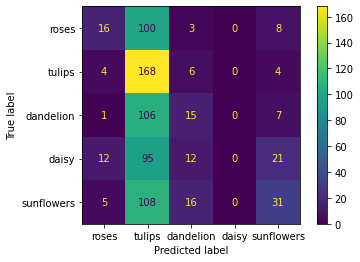

In [32]:
# displaying confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm3 = confusion_matrix(true_class3, predictions3)
print(cm3)
cmd = ConfusionMatrixDisplay(cm3, display_labels=['roses', 'tulips', 'dandelion', 'daisy', 'sunflowers'])
cmd.plot()

Classifying using Random forest

In [33]:
#Training Random forest 
import joblib
from sklearn.ensemble import RandomForestClassifier


clf_RF= RandomForestClassifier(n_estimators = 100, random_state=30)
clf_RF.fit(im_features, np.array(image_train_labels))
joblib.dump((clf_RF, training_names, stdSlr, k, voc), "bovw_RF2.pkl", compress=3)  

['bovw_RF2.pkl']

In [34]:
import cv2
import numpy as np
import os
import pylab as pl
from sklearn.metrics import confusion_matrix, accuracy_score
import joblib
from scipy.cluster.vq import vq  
import numpy

# Loading the stored classifier, class names, scaler, number of clusters and vocabulary 
clf, classes, stdSlr, k, voc = joblib.load("bovw_RF2.pkl")

 #SIFT descriptor
sift = cv2.xfeatures2d.SIFT_create()
des_list = []

for i in range(0,len(test_examples)):
  img=cv2.imread(test_examples[i][0])
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  frames,descriptors = sift.detectAndCompute(img, None)
  #sift_image = cv2.drawKeypoints(gray,frames, img)
  # show the image
  #cv2_imshow(sift_image)
  des_list.append((test_examples[i][0], descriptors)) 



# Stacking  descriptors vertically
descriptors = des_list[0][1]
for image_path, descriptor in des_list[0:]:
    descriptors = np.vstack((descriptors, descriptor)) 

# Calculating the histogram of features

test_features = np.zeros((len(test_examples), k), "float32")
for i in range(len(test_examples)):
    words, distance = vq(des_list[i][1],voc)
    for w in words:
        test_features[i][w] += 1

# Vectorization
nbr_occurences = np.sum( (test_features > 0) * 1, axis = 0)
idf = np.array(np.log((1.0*len(image_test_paths)+1) / (1.0*nbr_occurences + 1)), 'float32')

# Standardizing features
test_features = stdSlr.transform(test_features)


#Predictions
true_class4 =  [classes[i] for i in image_test_labels]
# Perform the predictions and report predicted class names. 
predictions4 =  [classes[i] for i in clf.predict(test_features)]



#Print the true class and Predictions 
print ("true classes are "  + str(true_class4))
print ("predicted classes are ="  + str(predictions4))

accuracy = accuracy_score(true_class4, predictions4)
print ("accuracy = ", accuracy*100)


true classes are ['dandelion', 'dandelion', 'tulips', 'sunflowers', 'daisy', 'roses', 'sunflowers', 'daisy', 'roses', 'tulips', 'sunflowers', 'tulips', 'roses', 'tulips', 'dandelion', 'tulips', 'tulips', 'daisy', 'tulips', 'dandelion', 'tulips', 'dandelion', 'tulips', 'dandelion', 'dandelion', 'sunflowers', 'dandelion', 'dandelion', 'daisy', 'tulips', 'dandelion', 'tulips', 'dandelion', 'tulips', 'daisy', 'dandelion', 'sunflowers', 'sunflowers', 'roses', 'dandelion', 'sunflowers', 'dandelion', 'dandelion', 'tulips', 'daisy', 'tulips', 'roses', 'dandelion', 'dandelion', 'roses', 'daisy', 'roses', 'dandelion', 'roses', 'dandelion', 'sunflowers', 'dandelion', 'sunflowers', 'tulips', 'daisy', 'dandelion', 'tulips', 'dandelion', 'dandelion', 'daisy', 'roses', 'roses', 'daisy', 'daisy', 'daisy', 'tulips', 'sunflowers', 'sunflowers', 'roses', 'dandelion', 'sunflowers', 'daisy', 'dandelion', 'dandelion', 'sunflowers', 'dandelion', 'tulips', 'dandelion', 'tulips', 'tulips', 'roses', 'dandelion'

[[ 44  31   9  13  30]
 [  4 135   6  15  22]
 [  6  13  49  15  46]
 [ 10  27  10  79  14]
 [  8  24  23  19  86]]


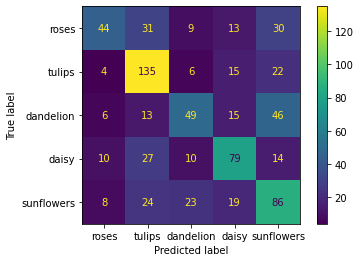

In [35]:
# displaying confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm4 = confusion_matrix(true_class4, predictions4)
print(cm4)
cmd = ConfusionMatrixDisplay(cm4, display_labels=['roses', 'tulips', 'dandelion', 'daisy', 'sunflowers'])
cmd.plot()

## **Evaluation**

### F1 score

In [36]:
from sklearn.metrics import f1_score

svm=f1_score(true_class3, predictions3, average=None)
rf=f1_score(true_class4, predictions4, average=None)
print("f1 score with SVM", svm)
print("\n")
print("f1 score with Random forest", rf)


f1 score with SVM [0.19393939 0.44268775 0.16574586 0.         0.26839827]


f1 score with Random forest [0.44221106 0.65533981 0.43362832 0.56227758 0.48044693]


### Accuracy, True Positive Rate, False positive rate

In [37]:
FP = cm3.sum(axis=0) - np.diag(cm3)  
FN = cm3.sum(axis=1) - np.diag(cm3)
TP = np.diag(cm3)
TN = 738 - (FP + FN + TP)

# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)

# Fall out or false positive rate
FPR = FP/(FP+TN)

# Overall accuracy
ACC = (TP+TN)/(TP+FP+FN+TN)


FP2 = cm4.sum(axis=0) - np.diag(cm4)  
FN2 = cm4.sum(axis=1) - np.diag(cm4)
TP2 = np.diag(cm4)
TN2 = 738 - (FP2 + FN2 + TP2)

# Sensitivity, hit rate, recall, or true positive rate
TPR2 = TP2/(TP2+FN2)

# Fall out or false positive rate
FPR2 = FP2/(FP2+TN2)

# Overall accuracy
ACC2 = (TP2+TN2)/(TP2+FP2+FN2+TN2)

print("Accuracy with SVM", ACC)
print("Accuracy with Random forest", ACC2, "\n")

print("true positive rate with SVM", TPR )
print("true positive rate with Random forest", TPR2,"\n")

print("false positive rate with SVM", FPR)
print("false positive rate with Random forest", FPR2)

Accuracy with SVM [0.8197832  0.42682927 0.79539295 0.8102981  0.77100271]
Accuracy with Random forest [0.8495935  0.80758808 0.82655827 0.83333333 0.74796748] 

true positive rate with SVM [0.12598425 0.92307692 0.11627907 0.         0.19375   ]
true positive rate with Random forest [0.34645669 0.74175824 0.37984496 0.56428571 0.5375    ] 

false positive rate with SVM [0.03600655 0.73561151 0.06075534 0.         0.06920415]
false positive rate with Random forest [0.04582651 0.17086331 0.07881773 0.10367893 0.19377163]


## Qualitative Results

## For SVM

### Some Correctly Classified examples

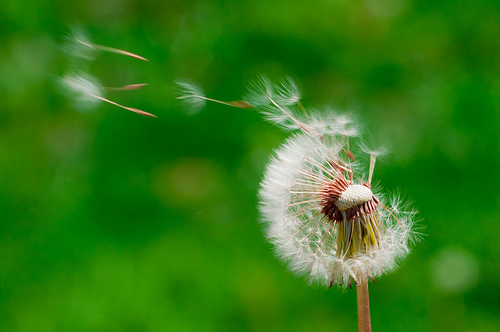

Actual label: dandelion
Predicted label: dandelion




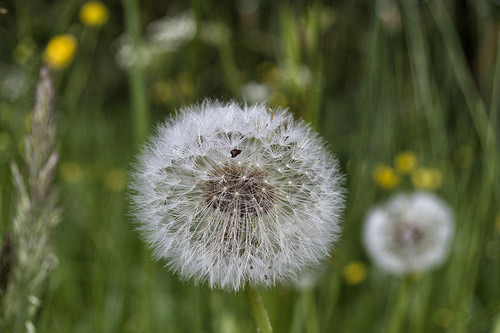

Actual label: dandelion
Predicted label: dandelion




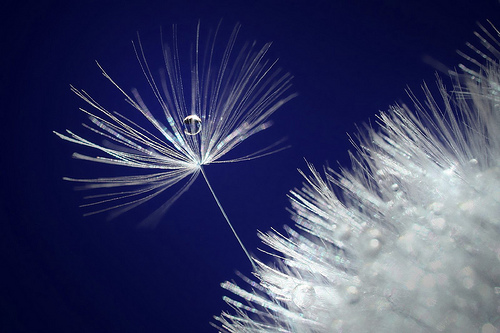

Actual label: dandelion
Predicted label: dandelion




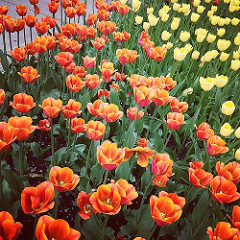

Actual label: tulips
Predicted label: tulips




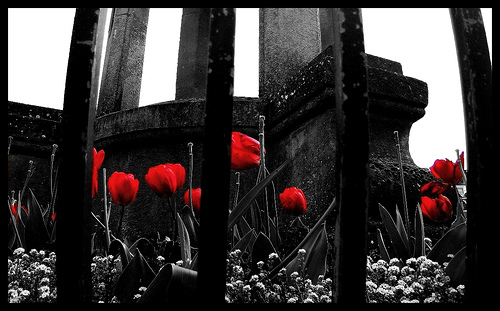

Actual label: tulips
Predicted label: tulips




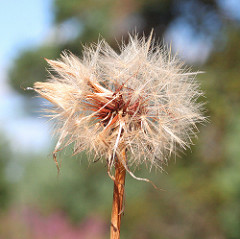

Actual label: dandelion
Predicted label: dandelion




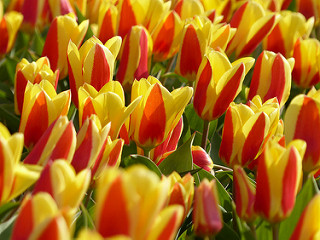

Actual label: tulips
Predicted label: tulips




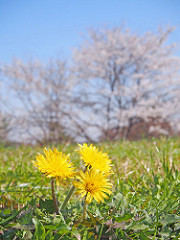

Actual label: dandelion
Predicted label: dandelion




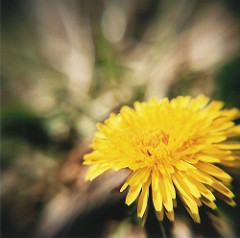

Actual label: dandelion
Predicted label: dandelion




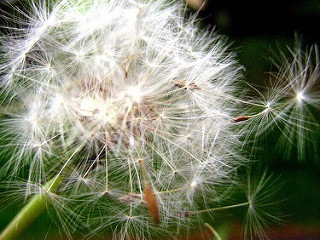

Actual label: dandelion
Predicted label: dandelion




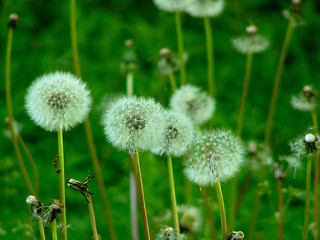

Actual label: dandelion
Predicted label: dandelion




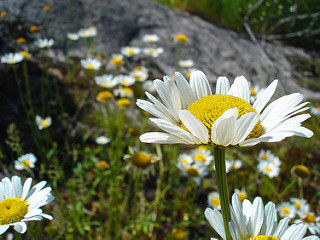

Actual label: daisy
Predicted label: daisy




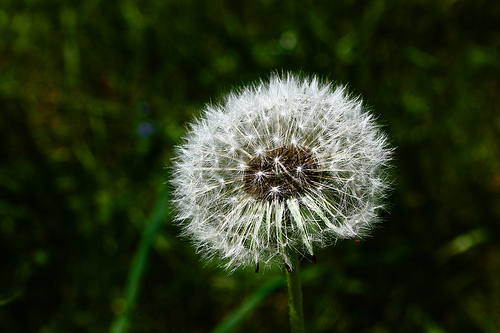

Actual label: dandelion
Predicted label: dandelion




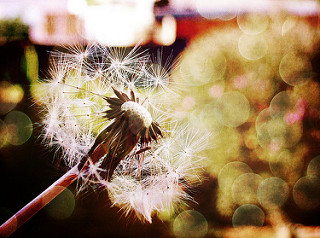

Actual label: dandelion
Predicted label: dandelion




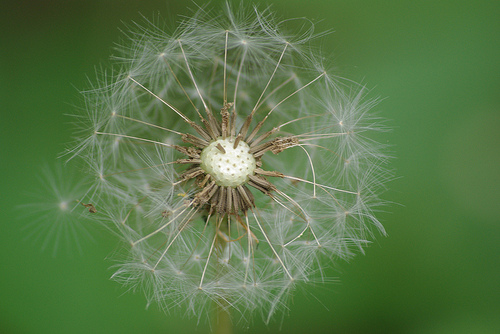

Actual label: dandelion
Predicted label: dandelion




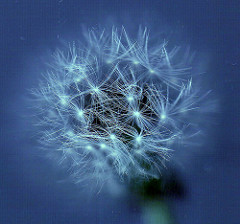

Actual label: dandelion
Predicted label: dandelion




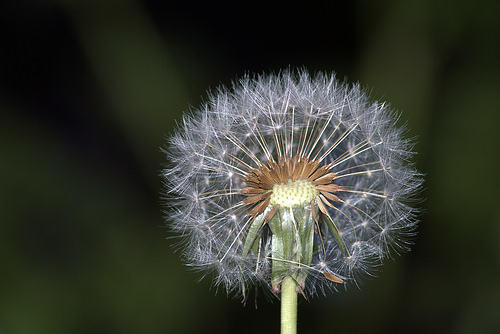

Actual label: dandelion
Predicted label: dandelion




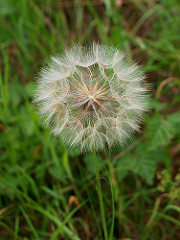

Actual label: dandelion
Predicted label: dandelion




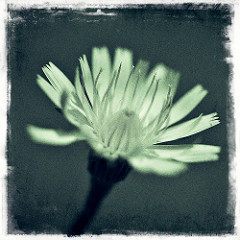

Actual label: dandelion
Predicted label: dandelion




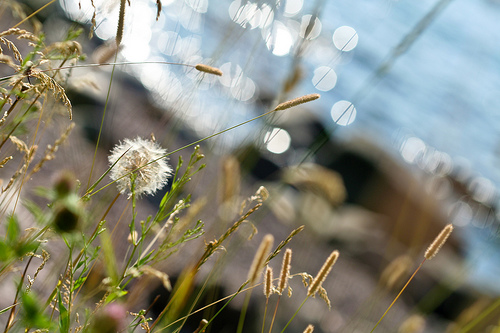

Actual label: dandelion
Predicted label: dandelion




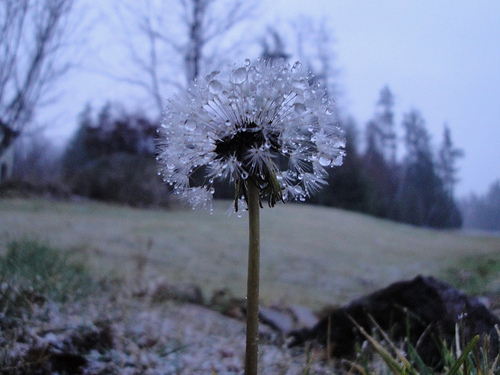

Actual label: dandelion
Predicted label: dandelion




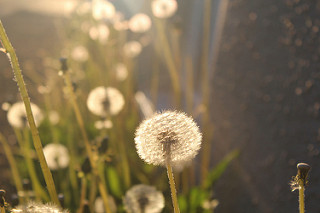

Actual label: dandelion
Predicted label: dandelion




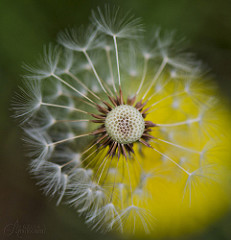

Actual label: dandelion
Predicted label: dandelion




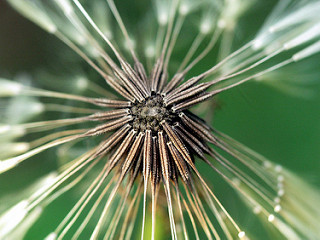

Actual label: dandelion
Predicted label: dandelion




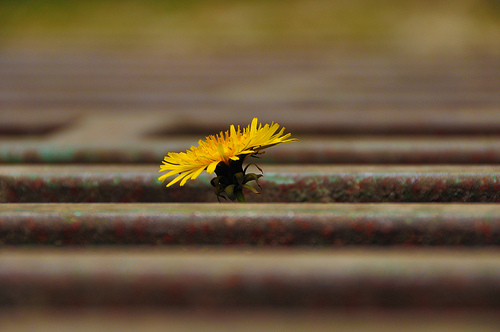

Actual label: dandelion
Predicted label: dandelion




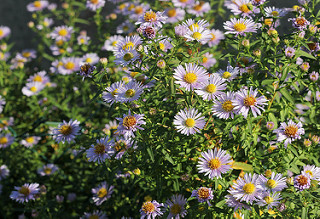

Actual label: daisy
Predicted label: daisy




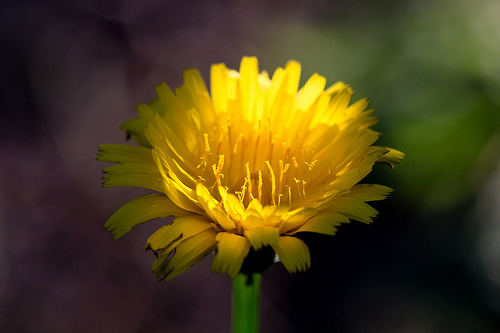

Actual label: dandelion
Predicted label: dandelion




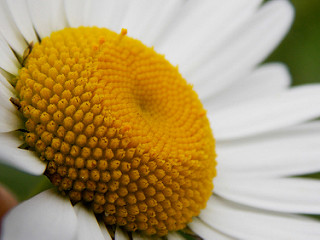

Actual label: daisy
Predicted label: daisy




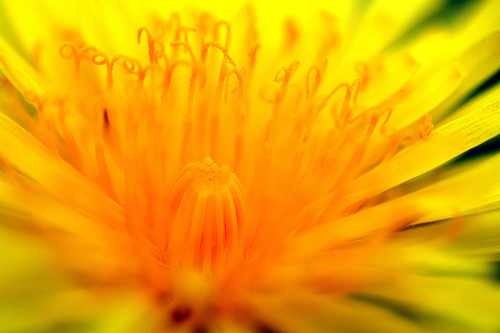

Actual label: dandelion
Predicted label: dandelion




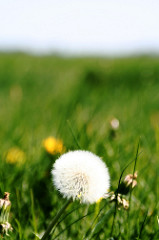

Actual label: dandelion
Predicted label: dandelion




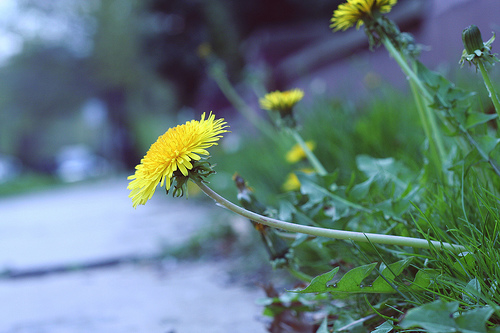

Actual label: dandelion
Predicted label: dandelion




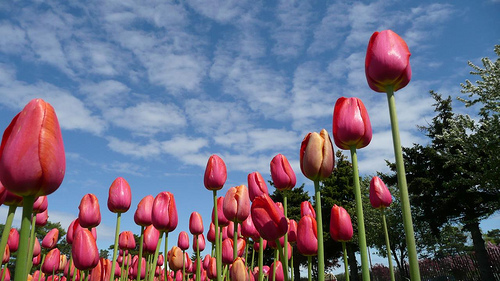

Actual label: tulips
Predicted label: tulips




In [38]:
for i in range(0,int(len(test_examples)/9)):
  if(true_class3[i]==predictions3[i]):
    img=cv2.imread(image_test_paths[i])
    cv2_imshow(img)
    print("Actual label:",true_class3[i])
    print("Predicted label:",predictions3[i])
    print("\n")

### Some Incorrectly Classified examples

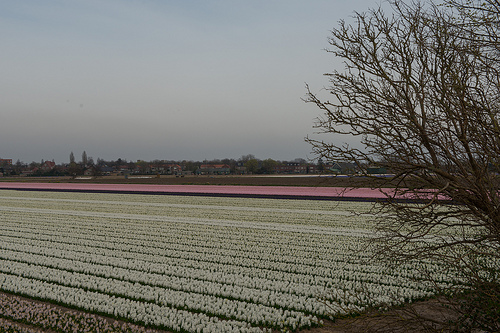

Actual label: tulips
Predicted label: dandelion




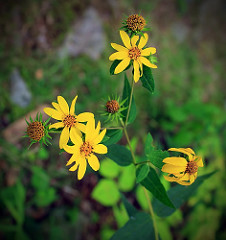

Actual label: sunflowers
Predicted label: dandelion




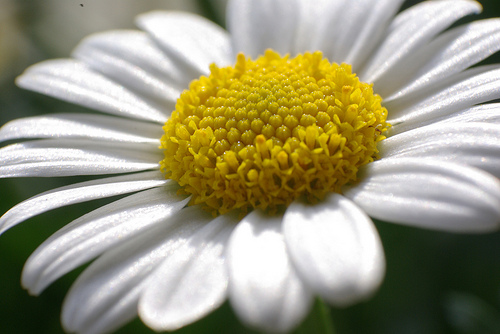

Actual label: daisy
Predicted label: dandelion




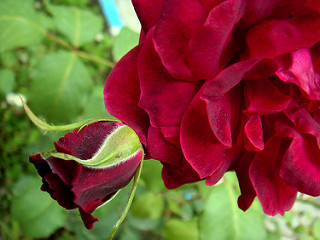

Actual label: roses
Predicted label: dandelion




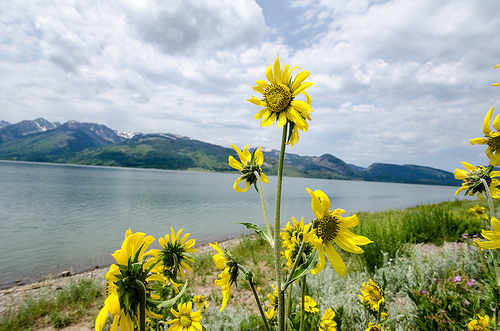

Actual label: sunflowers
Predicted label: dandelion




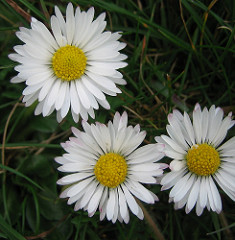

Actual label: daisy
Predicted label: dandelion




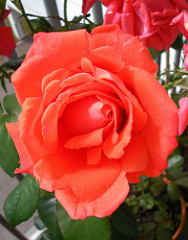

Actual label: roses
Predicted label: dandelion




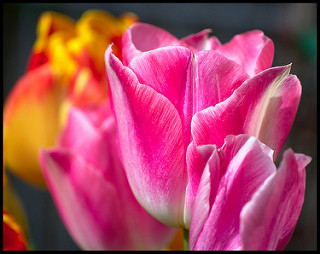

Actual label: tulips
Predicted label: dandelion




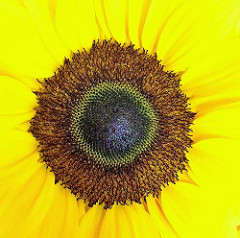

Actual label: sunflowers
Predicted label: dandelion




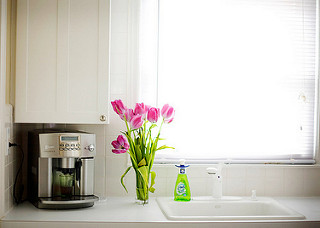

Actual label: tulips
Predicted label: dandelion




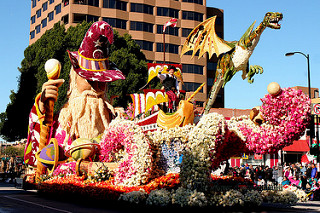

Actual label: roses
Predicted label: dandelion




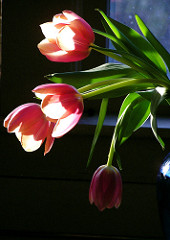

Actual label: tulips
Predicted label: dandelion




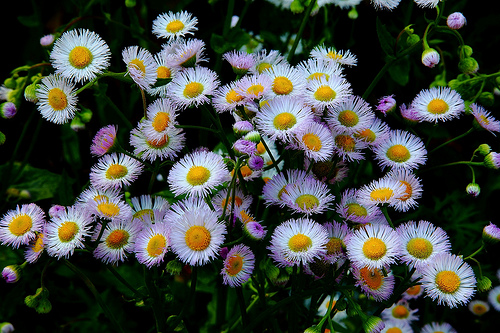

Actual label: daisy
Predicted label: dandelion




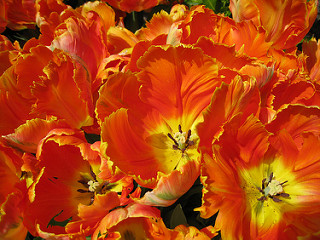

Actual label: tulips
Predicted label: dandelion




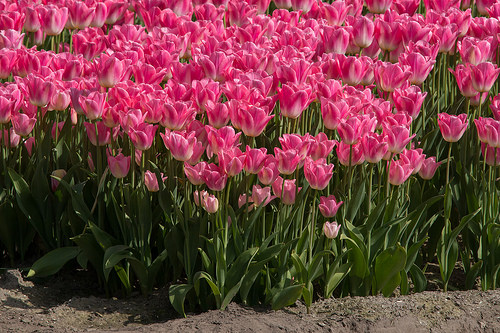

Actual label: tulips
Predicted label: roses




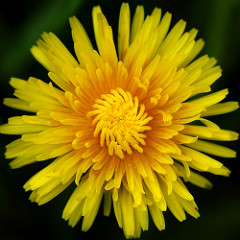

Actual label: dandelion
Predicted label: daisy




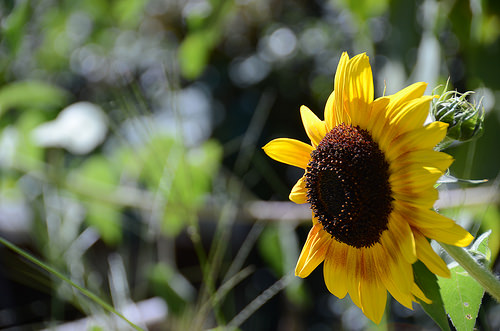

Actual label: sunflowers
Predicted label: dandelion




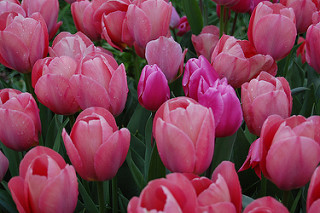

Actual label: tulips
Predicted label: dandelion




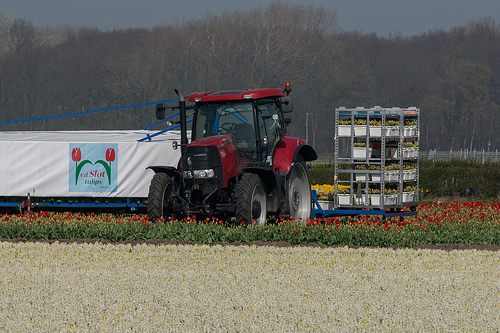

Actual label: tulips
Predicted label: dandelion




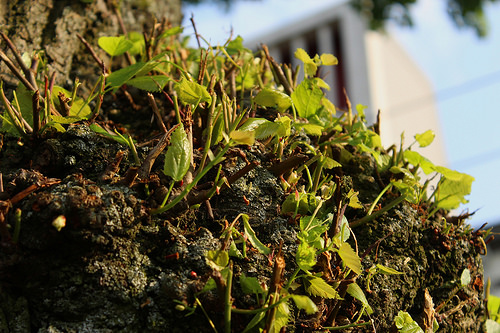

Actual label: tulips
Predicted label: roses




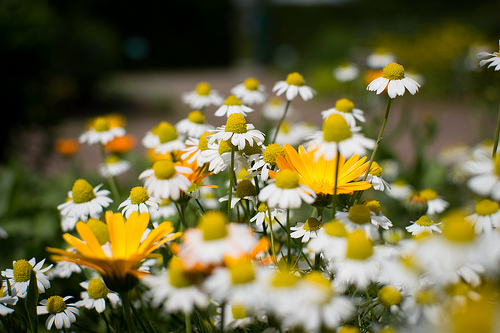

Actual label: daisy
Predicted label: dandelion




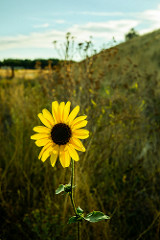

Actual label: sunflowers
Predicted label: dandelion




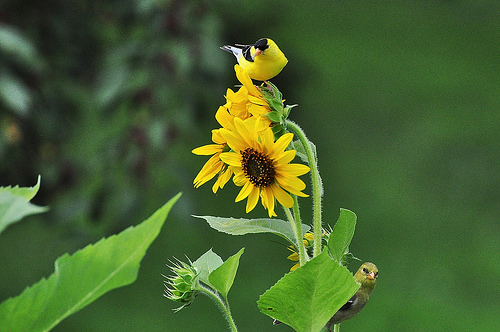

Actual label: sunflowers
Predicted label: dandelion




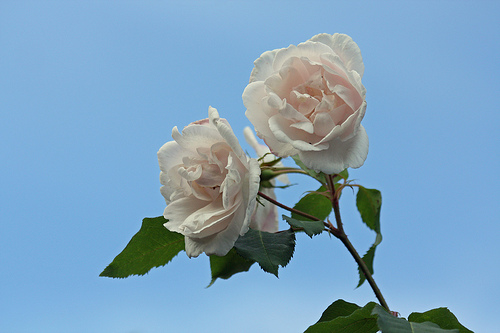

Actual label: roses
Predicted label: tulips




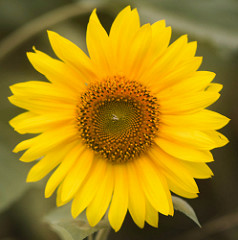

Actual label: sunflowers
Predicted label: dandelion




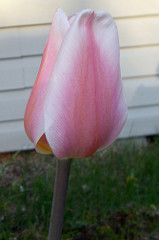

Actual label: tulips
Predicted label: dandelion




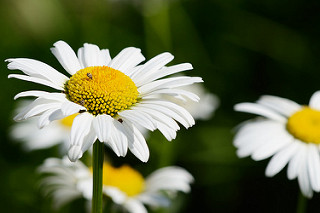

Actual label: daisy
Predicted label: dandelion




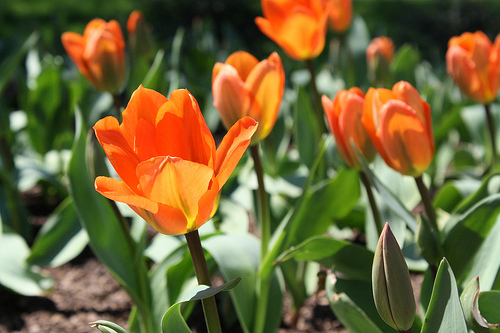

Actual label: tulips
Predicted label: dandelion




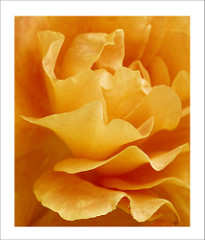

Actual label: roses
Predicted label: dandelion




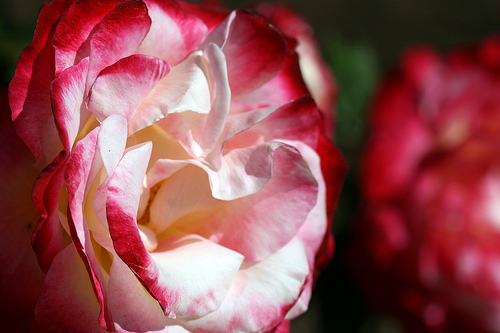

Actual label: roses
Predicted label: dandelion




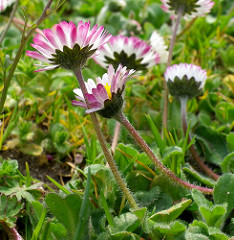

Actual label: daisy
Predicted label: dandelion




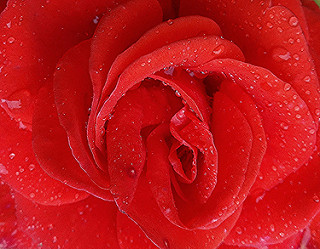

Actual label: roses
Predicted label: dandelion




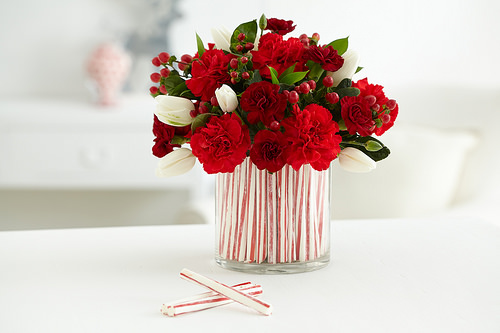

Actual label: roses
Predicted label: dandelion




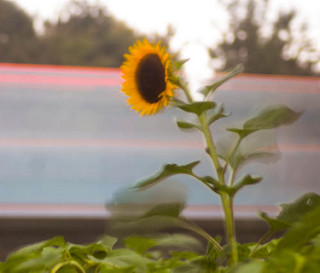

Actual label: sunflowers
Predicted label: dandelion




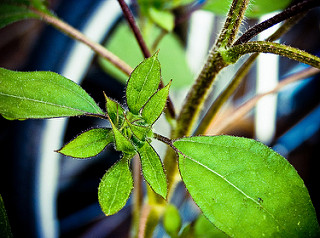

Actual label: sunflowers
Predicted label: dandelion




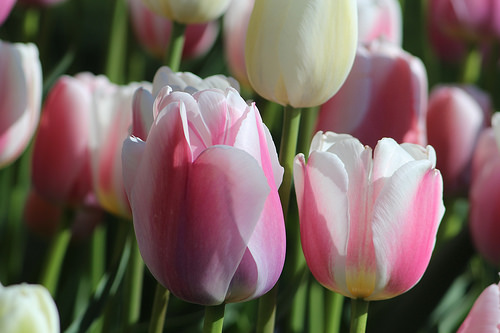

Actual label: tulips
Predicted label: dandelion




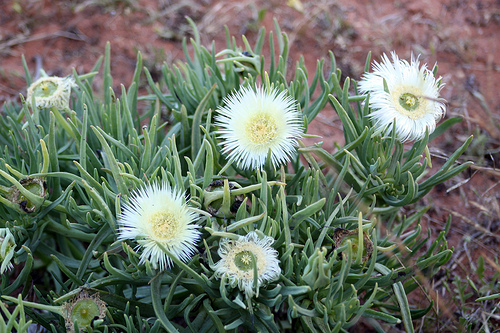

Actual label: daisy
Predicted label: roses




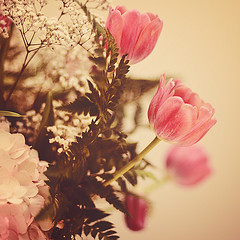

Actual label: tulips
Predicted label: dandelion




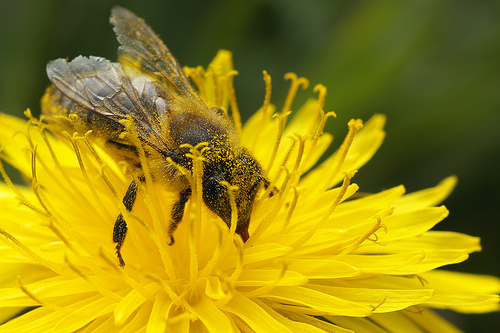

Actual label: dandelion
Predicted label: roses




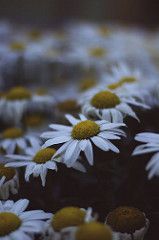

Actual label: daisy
Predicted label: dandelion




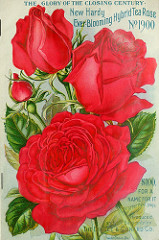

Actual label: roses
Predicted label: dandelion




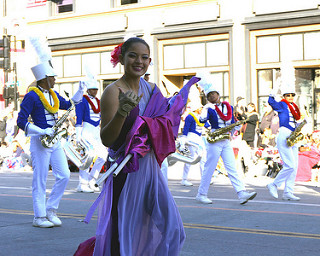

Actual label: roses
Predicted label: dandelion




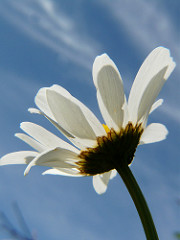

Actual label: daisy
Predicted label: dandelion




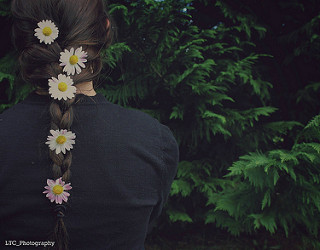

Actual label: daisy
Predicted label: dandelion




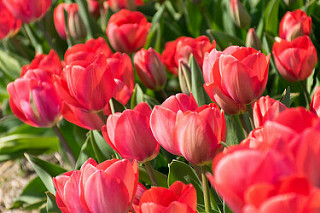

Actual label: tulips
Predicted label: dandelion




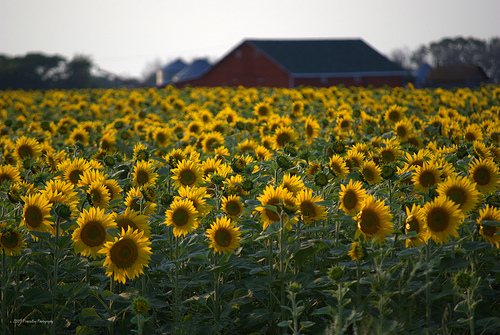

Actual label: sunflowers
Predicted label: tulips




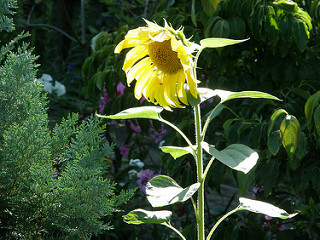

Actual label: sunflowers
Predicted label: dandelion




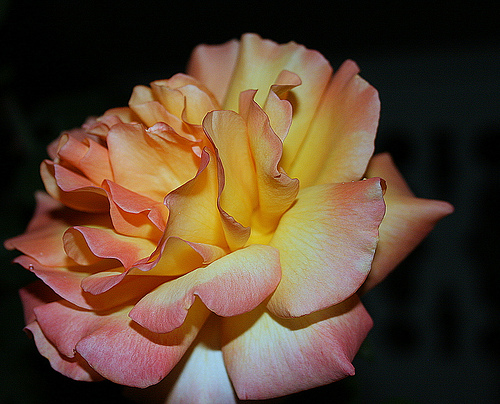

Actual label: roses
Predicted label: dandelion




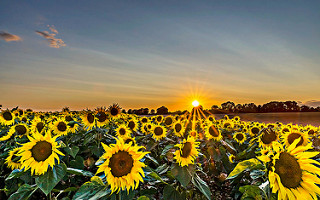

Actual label: sunflowers
Predicted label: dandelion




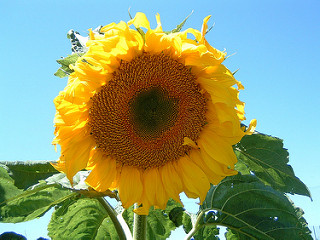

Actual label: sunflowers
Predicted label: dandelion




In [39]:
for i in range(0,int(len(test_examples)/9)):
  if(true_class3[i]!=predictions3[i]):
    img=cv2.imread(image_test_paths[i])
    cv2_imshow(img)
    print("Actual label:",true_class3[i])
    print("Predicted label:",predictions3[i])
    print("\n")

## For RF

### Some Correctly Classified examples

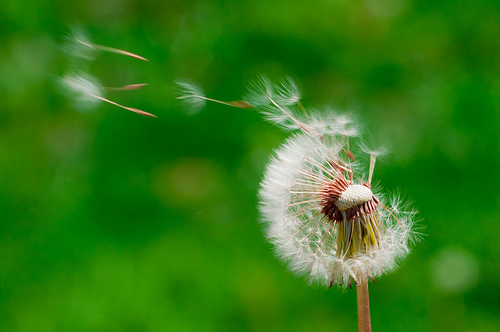

Actual label: dandelion
Predicted label: dandelion




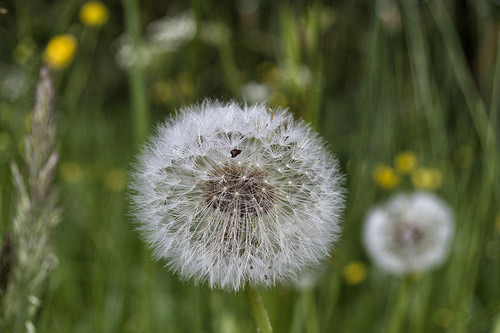

Actual label: dandelion
Predicted label: dandelion




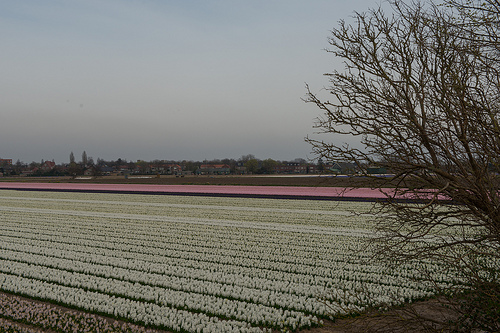

Actual label: tulips
Predicted label: tulips




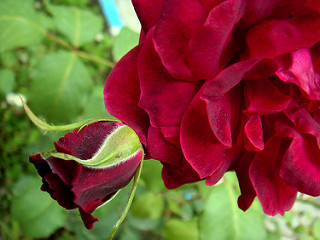

Actual label: roses
Predicted label: roses




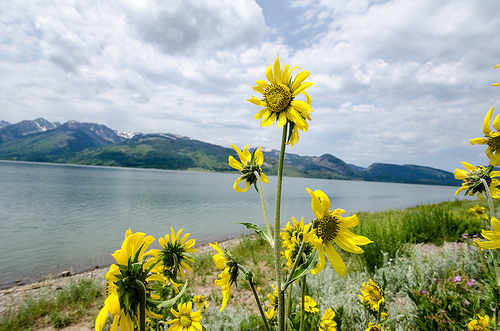

Actual label: sunflowers
Predicted label: sunflowers




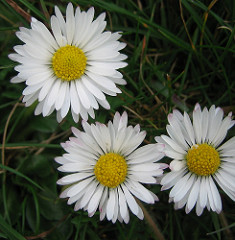

Actual label: daisy
Predicted label: daisy




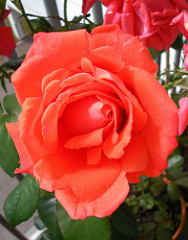

Actual label: roses
Predicted label: roses




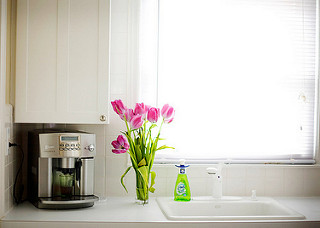

Actual label: tulips
Predicted label: tulips




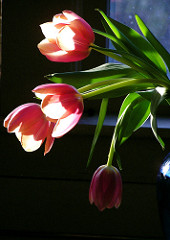

Actual label: tulips
Predicted label: tulips




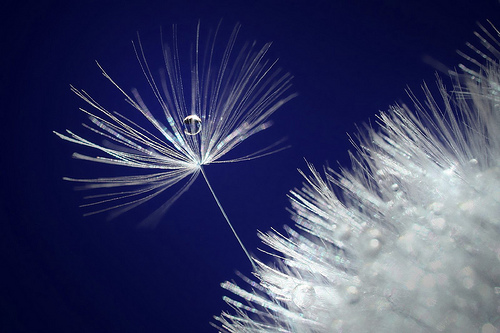

Actual label: dandelion
Predicted label: dandelion




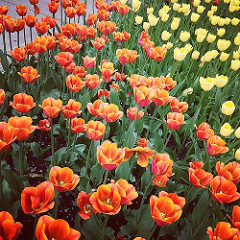

Actual label: tulips
Predicted label: tulips




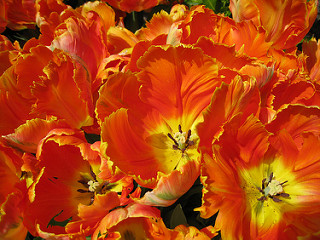

Actual label: tulips
Predicted label: tulips




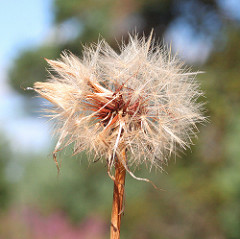

Actual label: dandelion
Predicted label: dandelion




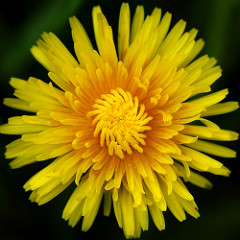

Actual label: dandelion
Predicted label: dandelion




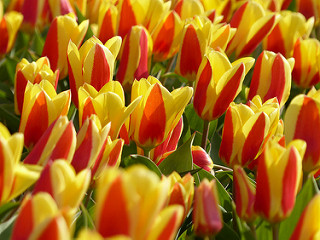

Actual label: tulips
Predicted label: tulips




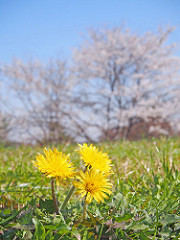

Actual label: dandelion
Predicted label: dandelion




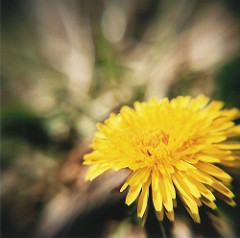

Actual label: dandelion
Predicted label: dandelion




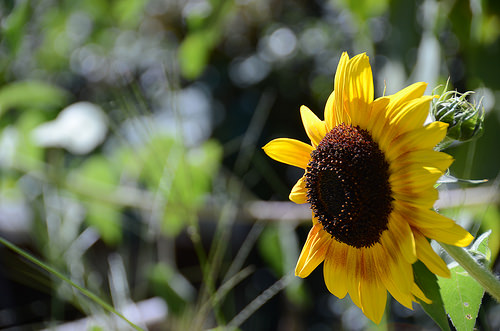

Actual label: sunflowers
Predicted label: sunflowers




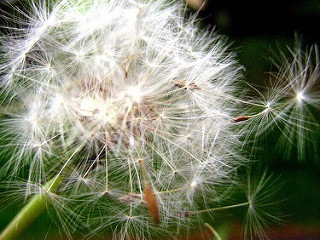

Actual label: dandelion
Predicted label: dandelion




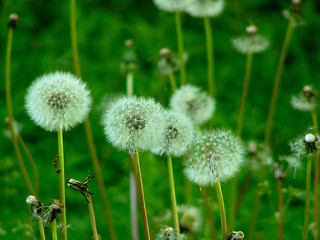

Actual label: dandelion
Predicted label: dandelion




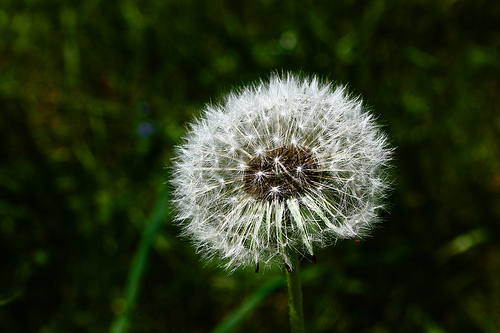

Actual label: dandelion
Predicted label: dandelion




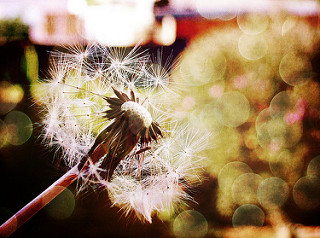

Actual label: dandelion
Predicted label: dandelion




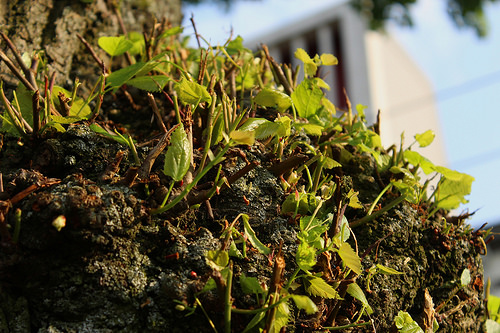

Actual label: tulips
Predicted label: tulips




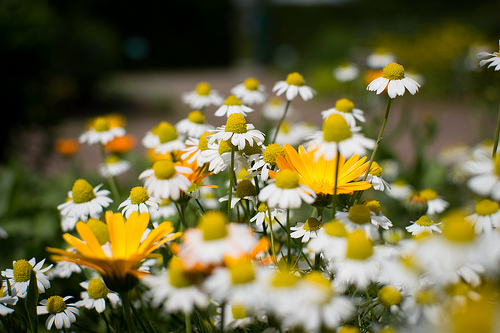

Actual label: daisy
Predicted label: daisy




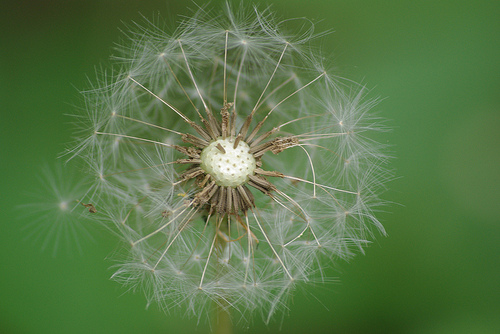

Actual label: dandelion
Predicted label: dandelion




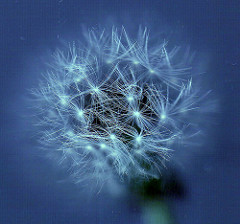

Actual label: dandelion
Predicted label: dandelion




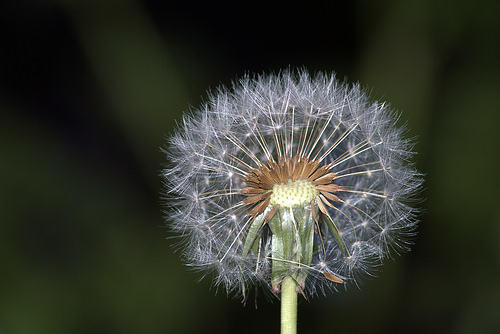

Actual label: dandelion
Predicted label: dandelion




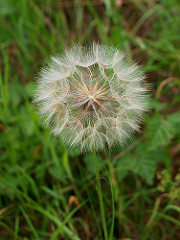

Actual label: dandelion
Predicted label: dandelion




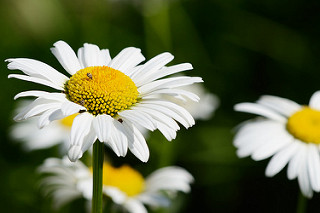

Actual label: daisy
Predicted label: daisy




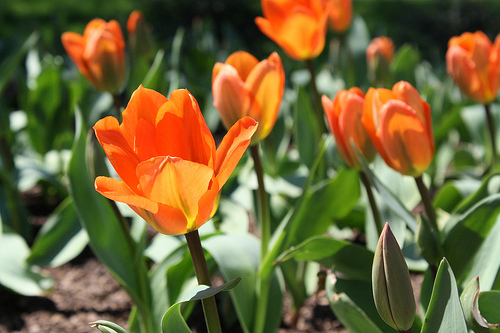

Actual label: tulips
Predicted label: tulips




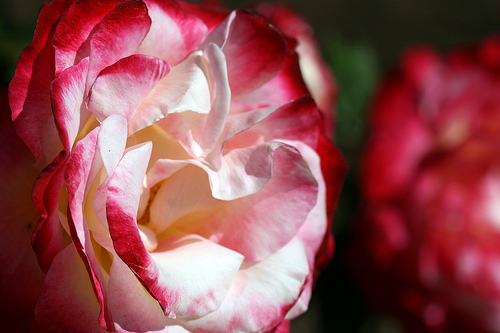

Actual label: roses
Predicted label: roses




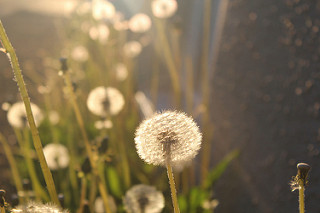

Actual label: dandelion
Predicted label: dandelion




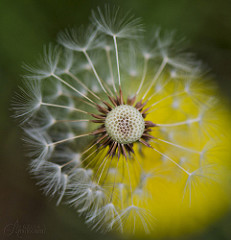

Actual label: dandelion
Predicted label: dandelion




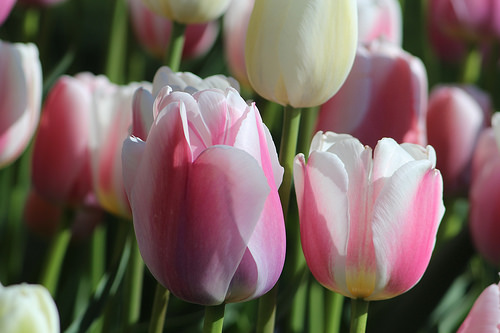

Actual label: tulips
Predicted label: tulips




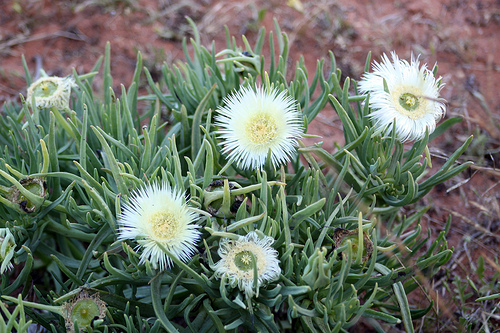

Actual label: daisy
Predicted label: daisy




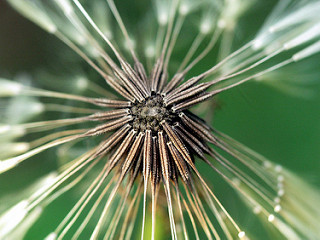

Actual label: dandelion
Predicted label: dandelion




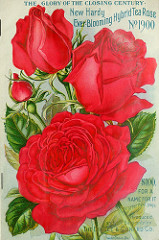

Actual label: roses
Predicted label: roses




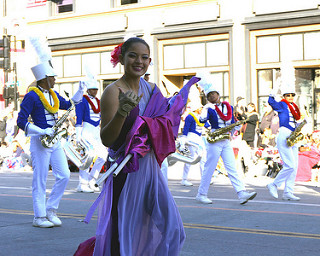

Actual label: roses
Predicted label: roses




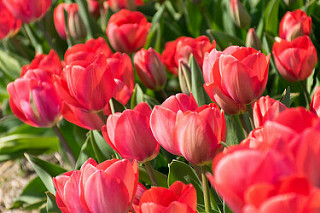

Actual label: tulips
Predicted label: tulips




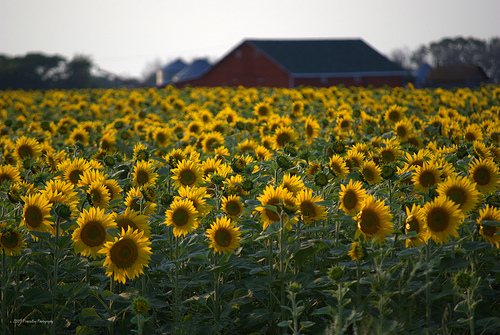

Actual label: sunflowers
Predicted label: sunflowers




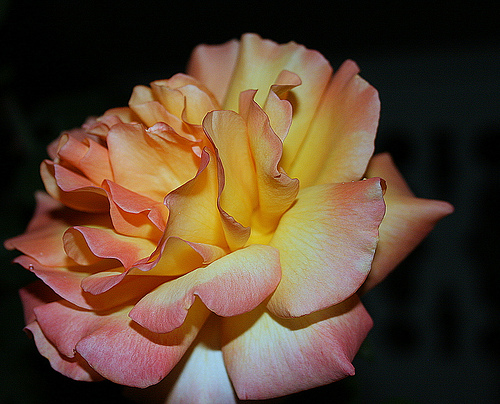

Actual label: roses
Predicted label: roses




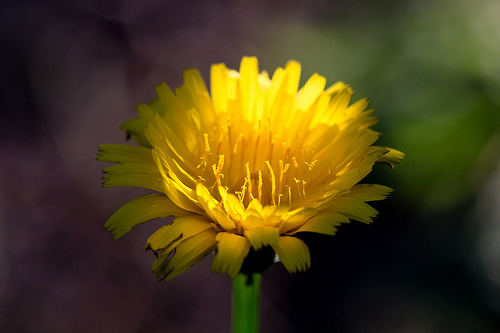

Actual label: dandelion
Predicted label: dandelion




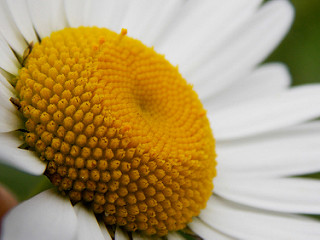

Actual label: daisy
Predicted label: daisy




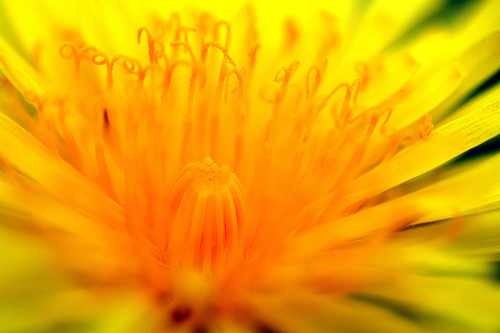

Actual label: dandelion
Predicted label: dandelion




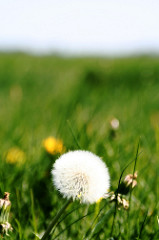

Actual label: dandelion
Predicted label: dandelion




In [40]:
for i in range(0,int(len(test_examples)/9)):
  if(true_class4[i]==predictions4[i]):
    img=cv2.imread(image_test_paths[i])
    cv2_imshow(img)
    print("Actual label:",true_class4[i])
    print("Predicted label:",predictions4[i])
    print("\n")

### Some Incorrectly Classified examples

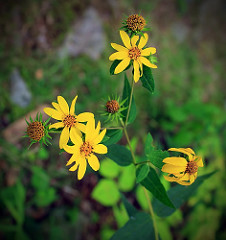

Actual label: sunflowers
Predicted label: dandelion




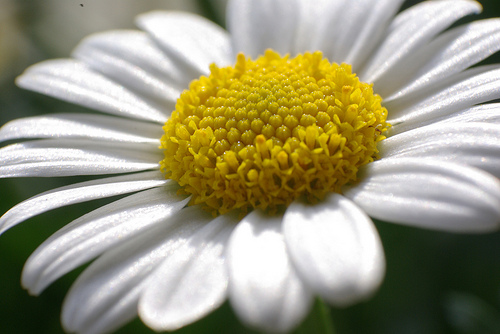

Actual label: daisy
Predicted label: tulips




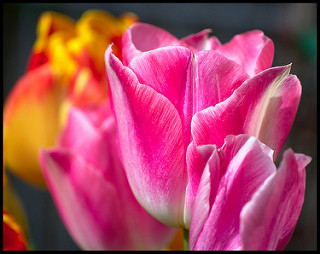

Actual label: tulips
Predicted label: roses




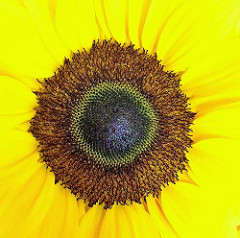

Actual label: sunflowers
Predicted label: dandelion




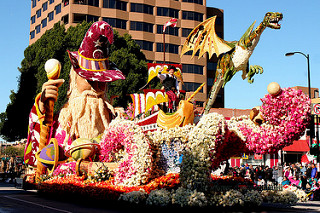

Actual label: roses
Predicted label: tulips




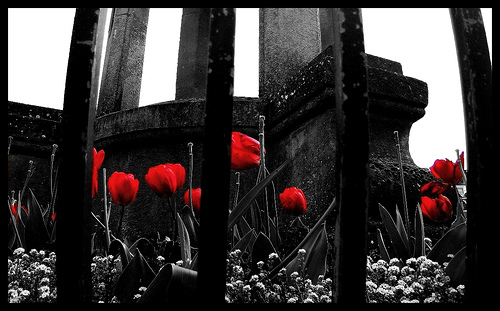

Actual label: tulips
Predicted label: roses




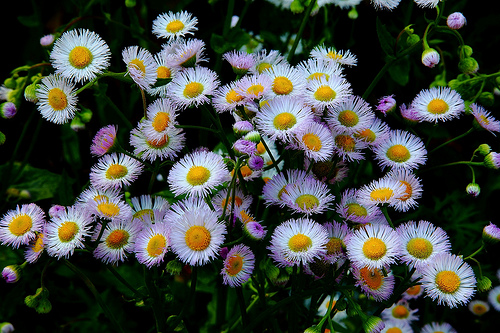

Actual label: daisy
Predicted label: roses




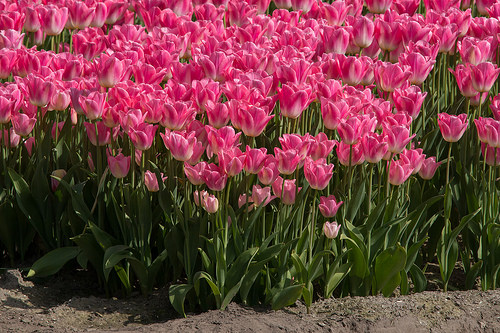

Actual label: tulips
Predicted label: sunflowers




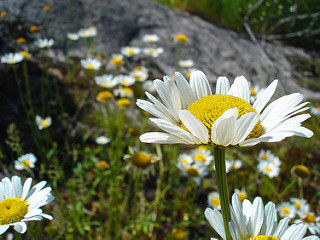

Actual label: daisy
Predicted label: tulips




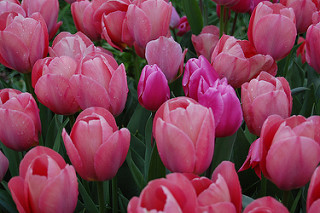

Actual label: tulips
Predicted label: roses




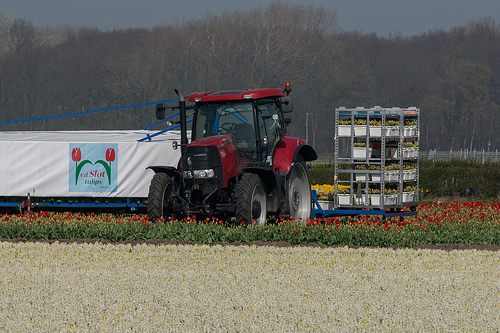

Actual label: tulips
Predicted label: roses




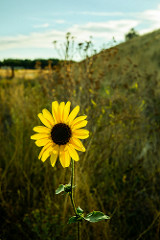

Actual label: sunflowers
Predicted label: dandelion




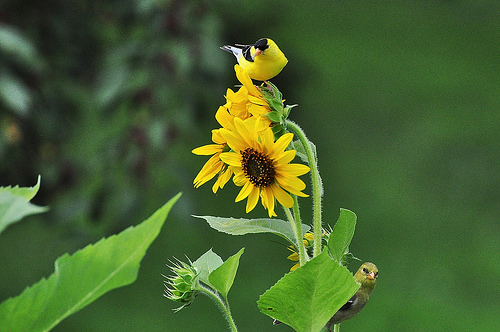

Actual label: sunflowers
Predicted label: tulips




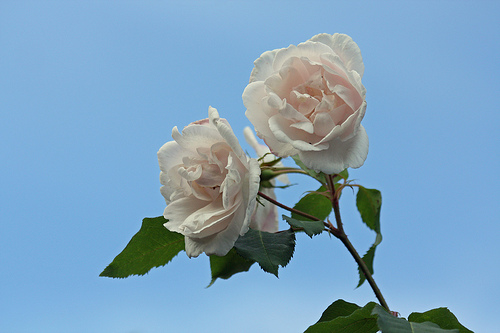

Actual label: roses
Predicted label: tulips




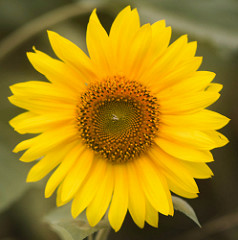

Actual label: sunflowers
Predicted label: daisy




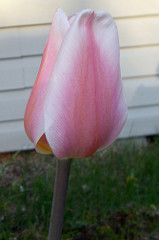

Actual label: tulips
Predicted label: dandelion




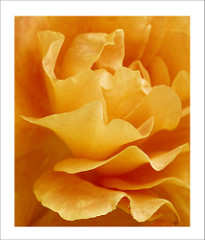

Actual label: roses
Predicted label: tulips




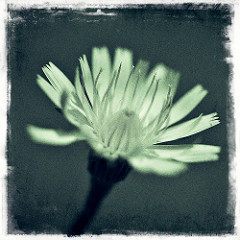

Actual label: dandelion
Predicted label: roses




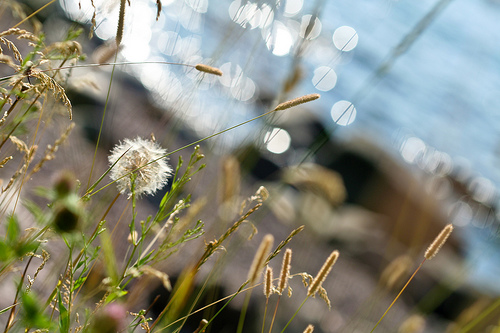

Actual label: dandelion
Predicted label: tulips




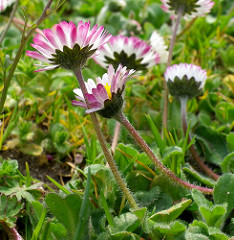

Actual label: daisy
Predicted label: tulips




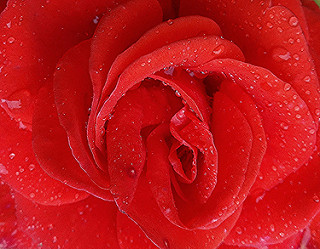

Actual label: roses
Predicted label: dandelion




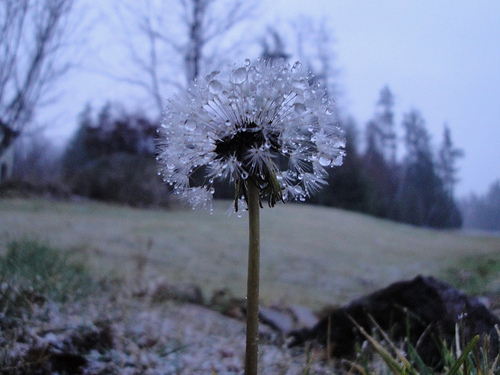

Actual label: dandelion
Predicted label: sunflowers




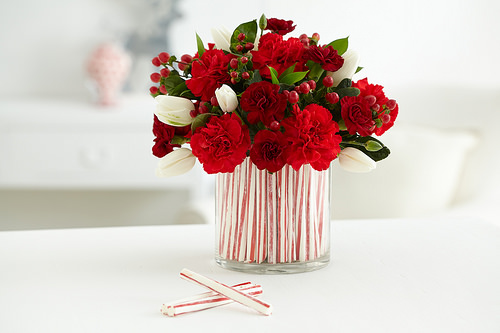

Actual label: roses
Predicted label: tulips




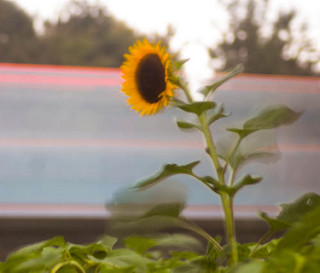

Actual label: sunflowers
Predicted label: tulips




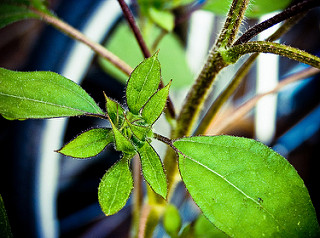

Actual label: sunflowers
Predicted label: tulips




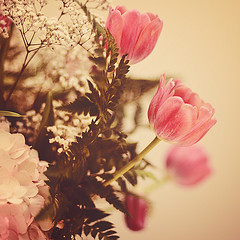

Actual label: tulips
Predicted label: dandelion




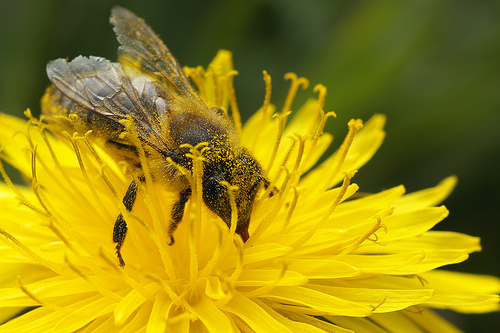

Actual label: dandelion
Predicted label: sunflowers




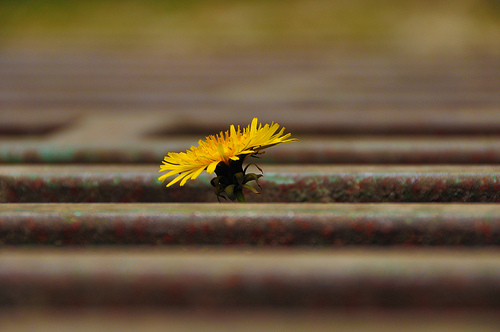

Actual label: dandelion
Predicted label: tulips




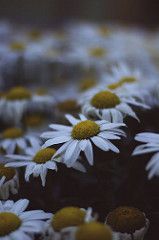

Actual label: daisy
Predicted label: dandelion




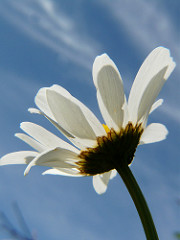

Actual label: daisy
Predicted label: tulips




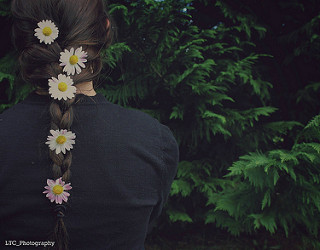

Actual label: daisy
Predicted label: dandelion




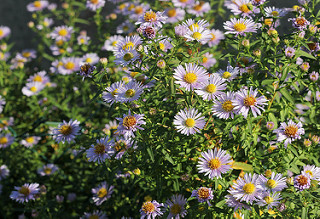

Actual label: daisy
Predicted label: tulips




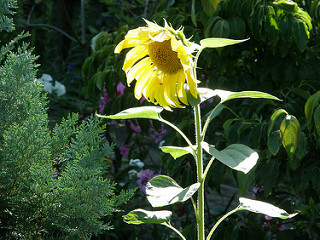

Actual label: sunflowers
Predicted label: tulips




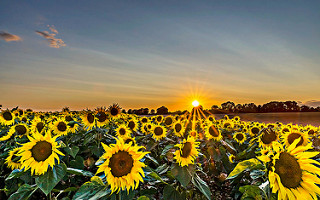

Actual label: sunflowers
Predicted label: dandelion




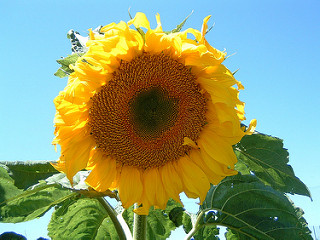

Actual label: sunflowers
Predicted label: tulips




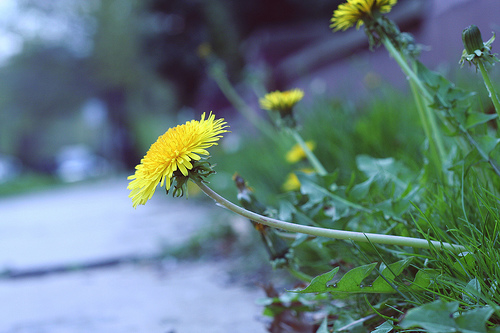

Actual label: dandelion
Predicted label: tulips




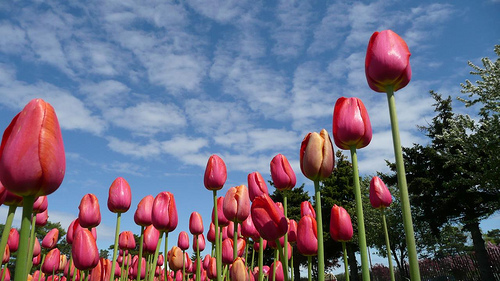

Actual label: tulips
Predicted label: dandelion




In [41]:
for i in range(0,int(len(test_examples)/9)):
  if(true_class4[i]!=predictions4[i]):
    img=cv2.imread(image_test_paths[i])
    cv2_imshow(img)
    print("Actual label:",true_class4[i])
    print("Predicted label:",predictions4[i])
    print("\n")